In [2]:
import torch
import torch.nn.functional as F
import seaborn as sns
from torch import Tensor
from transformers import AutoTokenizer, AutoModel
from taker import Model

In [2]:
# Generate texts and record activations on prompts

m = Model("nickypro/tinyllama-110m") # change to mistral when code works

prompts = [
    "A young dragon who can't breathe fire goes on a quest to find a magical cure.",
    "A group of animals start a detective agency in the forest to solve mysteries.",
    "A child with the power to talk to plants helps save the garden from a drought.",
    "Two siblings discover a secret door in their attic leading to a magical kingdom.",
    "A pirate ship crewed entirely by cats searches for the legendary Fish Island.",
    "A young witch struggles to control her powers while preparing for the annual magic festival.",
    "A robot befriends a lonely child and they embark on adventures in the city.",
    "An enchanted book transports a reader to the world within its pages for an adventure.",
    "A squirrel with amnesia tries to uncover its past with the help of forest friends.",
    "A knight in training must complete a quest to earn their armor, facing various challenges.",
    "A space explorer lands on a planet inhabited by alien creatures and learns about their culture.",
    "A magical bakery where the sweets grant wishes, but not always in the way the customer expects.",
    "A group of kids with superpowers form a team to protect their town from villains.",
    "A mermaid ventures onto land to find a lost treasure and learns about human customs.",
    "A time traveler visits various historical events, trying to fix a mistake without changing history.",
    "A young inventor creates a gadget that can change the weather, leading to unexpected adventures.",
    "An alien child stranded on Earth navigates school life while hiding their true identity.",
    "A ghost detective helps solve ghostly mysteries while uncovering the story of their own past.",
    "A magical zoo where the animals talk and the keeper learns lessons about friendship and courage.",
    "A fairy with broken wings learns the value of perseverance and finds a new way to fly.",
    "A brave knight embarks on a quest to defeat a powerful dragon and save a kingdom.",
    "A group of friends embark on a journey to the center of the earth, facing challenges and uncovering ancient secrets.",
    "A young wizard discovers a magical artifact that can turn any metal into gold.",
    "A team of explorers ventures into the depths of an ancient temple, encountering ancient beings and solving puzzles.",
    "A princess with a special gift must find a prince who can love her for what she is, facing challenges and making choices along the way.",
    "A detective with the ability to see into people's dreams investigates a series of unsolved murders.",
    "A group of friends embark on a quest to find a mythical creature that can grant wishes, facing danger and making new friends along the way.",
    "A prince with a special gift must find a princess who can love him for who he is, facing challenges and making choices along the way.",
    "A group of friends embark on a quest to find a mythical creature that can grant wishes, facing danger and making new friends along the way.",
    "A young prince embarks on a quest to defeat a powerful wizard and save his kingdom.",
    "A group of friends embark on a journey to the heart of the universe, facing challenges and uncovering cosmic secrets.",
    "A young witch discovers a magical artifact that can turn any substance into solid ice.",
    "A team of adventurers ventures into the depths of a mythical forest, encountering mythical beings and solving riddles.",
    "A princess with a special gift must find a prince who can love her for her unique beauty, facing challenges and making choices along the way.",
    "A detective with the ability to read people's minds investigates a series of unsolved crimes.",
    "A group of friends embark on a quest to find a mythical creature that can grant wishes, facing danger and making new friends along the way.",
    "A prince with a special gift must find a princess who can love him for his unique charisma, facing challenges and making choices along the way.",
    "A group of friends embark on a quest to find a mythical creature that can grant wishes, facing danger and making new friends along the way.",
    "A young prince embarks on a quest to defeat a powerful sorcerer and save his kingdom.",
    "A group of friends embark on a journey to the core of the multiverse, facing challenges and uncovering parallel realities.",
    "A young wizard discovers a magical artifact that can turn any object into a living creature.",
    "A team of adventurers ventures into the depths of a forbidden temple, encountering ancient guardians and solving puzzles.",
    "A princess with a special gift must find a prince who can love her for her unique spirit, facing challenges and making choices along the way.",
    "A detective with the ability to sense danger investigates a series of unsolved crimes.",
    "A group of friends embark on a quest to find a mythical creature that can grant wishes, facing danger and making new friends along the way.",
    "A prince with a special gift must find a princess who can love him for his unique courage, facing challenges and making choices along the way.",
    "A wizard in a modern city discovers an ancient spell that can alter time.",
    "A group of children find a map leading to an underwater city.",
    "A scientist creates a machine that allows animals to speak to humans.",
    "A lost puppy with magical powers embarks on a journey to find its home.",
    "A haunted library where books come to life and share their stories.",
    "An alien family trying to live a normal life in a suburban neighborhood.",
    "A secret society of time travelers working to prevent historical disasters.",
    "A magical mirror that shows the viewer what they most need to see.",
    "A world where shadows can detach and lead lives of their own.",
    "A garden where the plants can grant wishes to those who care for them.",
    "A child who can change the weather with their emotions.",
    "A city floating in the sky, hidden from the world below.",
    "A bakery where the pastries are imbued with emotions, affecting those who eat them.",
    "A school for young superheroes, focusing on how to use powers responsibly.",
    "An underground city illuminated by glowing crystals, unknown to the surface world.",
    "A mountain that changes location every day, hiding a powerful secret.",
    "A museum where the exhibits come alive at night.",
    "A planet where the seasons change every day.",
    "A girl who can teleport, but only to places she's seen in pictures.",
    "A boy who befriends a ghost, and together they solve mysteries.",
    "A kingdom where music is magic, and a young bard holds the key to saving it.",
    "A forest that remembers everything that happens within it.",
    "A game where the players enter a virtual world, but some can't escape.",
    "A world divided by day and night, with different creatures ruling each.",
    "A necklace that allows the wearer to understand animals.",
    "A diary that writes back to its owner, offering advice and secrets.",
    "A town where everyone can fly, but one child cannot.",
    "A watch that can rewind time, but only for five minutes.",
    "A pair of glasses that can see into the future, but only 24 hours ahead.",
    "A book that transports the reader to the world it describes, but they can't control where.",
    "An island that appears only once every hundred years.",
    "A castle that rearranges its rooms every night.",
    "A family moves into a house that's a gateway to other dimensions.",
    "A pen that brings drawings to life.",
    "A world where every person has a robotic animal companion.",
    "A competition to become the next wizard king of a magical realm.",
    "A device that allows people to share dreams.",
    "A coat that renders the wearer invisible during the day.",
    "A girl who can transform into any animal she has seen.",
    "A boy with the ability to speak any language, including those of aliens.",
    "A camera that captures the future.",
    "A village where the stars predict the future, and a young astrologer uncovers a mystery.",
    "A world where books are banned, and a group of rebels fight to bring them back.",
    "A pair of boots that can take the wearer anywhere in the world in a single step.",
    "A hat that grants the wearer the ability to read minds.",
    "A world where every person has their own personal cloud that reflects their mood.",
    "A ring that allows the wearer to walk through walls.",
    "A bracelet that changes color to indicate the presence of magic.",
    "A door that leads to a different world every time it's opened.",
    "A world where people are born with tattoos that signify their destiny.",
    "A map that shows the location of lost things.",
    "A compass that points to what the holder needs most.",
    "A world where shadows whisper secrets to those who listen.",
    "A town where every full moon, people turn into animals.",
    "A mirror that reflects the true self, revealing hidden truths.",
    "A lake that shows visions of the future.",
    "A world where art is the highest form of magic.",
    "A library with books that can transport readers to the story's setting.",
    "A potion that allows the drinker to understand the language of nature.",
    "A world where each person has a spirit animal guide.",
    "A tree that grows money instead of leaves, guarded by a mysterious creature.",
    "A pair of earrings that allow the wearer to hear thoughts.",
    "A world where the sea is a gateway to other worlds.",
    "A locket that stores memories, allowing the wearer to relive them.",
    "A world where every person can choose their own gravity direction.",
    "A lighthouse that guides lost travelers between worlds, not just at sea.",
    "A pair of gloves that allow the wearer to sculpt anything out of air.",
    "A world where one's shadow grows with their lies, causing mistrust and intrigue.",
    "A village on the back of a giant, wandering turtle, always in search of water.",
    "A crown that allows the ruler to hear the thoughts of their subjects.",
    "A cave that amplifies one's deepest desires, leading many to their fortune or doom.",
    "A world where rain falls only once a decade, sparking a festival that decides the fate of its people.",
    "A train that travels through time, carrying passengers to key historical events.",
    "A pair of binoculars that show the world as it will be in 100 years.",
    "A world where each person can only speak a thousand words per day.",
    "A forest where the trees are invisible, making navigation a challenge for explorers.",
    "A bookshop where each book contains a real world to explore.",
    "A pen that can write stories that come true, but at a cost.",
    "A city where buildings float in the air, tethered to the ground by chains.",
    "A watch that counts down to the wearer's most significant life events.",
    "A garden where every plant is a different color of the rainbow.",
    "A telescope that shows other galaxies as if they were close enough to touch.",
    "A world where music is the source of power, and instruments are fiercely protected.",
    "A bridge that connects two points in time, not just two places.",
    "A hat that changes shape based on the wearer's mood.",
    "A world where everyone has a doppelgänger from a parallel universe.",
    "A door that only opens on the leap year, revealing a secret world.",
    "A world where dreams are harvested as a form of energy.",
    "A compass that leads to the thing you desire most, but not always in the way you expect.",
    "A library where the books predict the future of whoever reads them.",
    "A marketplace where one can buy and sell emotions.",
    "A world where the stars in the sky are actually distant cities.",
    "A coat that protects the wearer from any harm, but at the expense of their happiest memory.",
    "A mirror that shows alternate versions of oneself, living different lives.",
    "A world where the wind can carry away thoughts, leading to a society focused on mindfulness.",
    "A box that contains an entire universe, with its own planets and civilizations.",
    "A world where shadows are solid and can be manipulated like clay.",
    "A river that flows uphill, defying gravity and leading to a mystical source.",
    "A world where every person's heart is a different gemstone, reflecting their essence.",
    "A painting that ages instead of its owner, who remains young as long as they possess it.",
    "A world where seasons change at random, creating a society adaptable to sudden snow or sun.",
    "A locket that lets the wearer speak with animals.",
    "A city built inside a massive, ancient tree, protected from the outside world.",
    "A diary that records not just thoughts and events, but the future as it will unfold.",
    "A world where people can exchange their talents, leading to a complex economy of skills.",
    "A spell that allows one to step into paintings and explore the worlds within.",
    "A key that can unlock any door, but also unlocks the secrets hidden behind it.",
    "A world where people sleep for years at a time, waking only for a few months to live intensely.",
    "A mountain that whispers secrets to those who climb it, offering wisdom or madness.",
    "A world where the sea is above the sky, and ships sail through clouds to reach distant lands.",
    "A ring that allows the wearer to experience the world in slow motion, seeing details otherwise missed.",
    "A world where mirrors are portals to parallel worlds, but one can never return to the same world twice.",
    "A tree that bears fruit only once a century, said to grant immortality to those who taste it.",
    "A book that rewrites itself to adapt to the reader's interests, but may also alter their desires.",
    "A world where night never falls, and society has evolved without the concept of sleep.",
    "A pair of shoes that allow the wearer to walk on water, leading to a new era of exploration.",
    "A world where one's lifespan is determined by the number of words they speak.",
    "A fountain that grants the drinker a glimpse of their future, but the vision is always open to interpretation.",
    "A world where the gravity changes direction daily, requiring inhabitants to adapt constantly.",
    "A map that leads to a treasure, revealing the heart's true desires along the way.",
    "A world where colors are flavors, and people can taste the rainbow in a literal sense.",
    "A clock that can pause time, but only for an hour a day, creating a hidden society of time-benders.",
    "A world where your name determines your destiny, leading to a society obsessed with choosing the right names.",
    "A pair of scissors that can cut portals into other worlds.",
    "A world where your reflection shows who you were in a past life, revealing secrets and hidden talents.",
    "A village where every house is alive and has its own personality, becoming a lifelong companion to its inhabitants.",
    "A world where every full moon brings a different magical effect, from floating objects to talking animals.",
    "A hat that allows the wearer to jump incredibly high, exploring rooftops and treetops with ease.",
    "A world where you can borrow someone else's appearance, but only if they agree to borrow yours in return.",
    "A book that absorbs the reader, making them a character in its story until someone else opens it.",
    "A world where silence is solid, and can be sculpted and crafted into objects or barriers.",
    "A necklace that allows one to revisit old memories, but also to change small details, altering the present in unpredictable ways.",
    "A world where each morning, people wake up with a random new skill or knowledge, but it only lasts for a day.",
    "A bridge made of light, connecting the earth to the stars, only visible to those who believe it's there.",
    "A world where shadows protect their owners, fighting off dangers in a parallel shadow world.",
    "A book that can only be read by moonlight, revealing secrets about the night world and its inhabitants.",
    "A world where water acts as a portal to other places, but one never knows where they'll emerge.",
    "A garden where the flowers sing at dawn, their melodies holding the power to heal or enchant.",
    "A world where each person has a unique melody that describes their life, and musicians can read people's stories through their songs.",
    "A pair of glasses that reveal the history of anything they focus on, showing its past and potential futures.",
    "A world where people grow wings when they reach adulthood, but the color and size are determined by their actions and personality.",
    "A clock tower that doesn't tell the current time but instead shows significant moments in the town's history.",
    "A world where rain is as colorful as a rainbow, each color with its own unique effect or emotion.",
    "A library where the books are endless tunnels, and readers walk through stories, living them as they go.",
    "A world where people can store their memories in jars, but risk forgetting them if the jar is broken.",
    "A mirror that swaps the viewer's place with their reflection, offering a chance to live a day in a parallel world.",
    "A world where the wind carries whispers from the future, warning or advising those who listen closely.",
    "A pair of boots that leave glowing footprints, leading the way home or to hidden treasures, depending on the wearer's needs.",
    "A world where every person has a personal rain cloud, reflecting their mood and changing the weather around them."
]


gen_len = 150

activations = [m.get_text_activations(text=i) for i in prompts]
residual_stream = [m.get_residual_stream(text=i) for i in prompts]

generated_texts = [m.generate(i, gen_len, temperature=0.7, do_sample=True)[1] for i in prompts]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/686 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.84M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/411 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/219M [00:00<?, ?B/s]

/usr/local/share/miniconda/envs/mistral2/lib/python3.9/site-packages/torch/_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


generation_config.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

- Loaded nickypro/tinyllama-110m
 - Registered 12 Attention Layers
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 34, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 22, 768])
torch.Size([1, 22, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31,

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 33, 768])
torch.Size([1, 33, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 31, 768])
torch.Size([1, 31, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19,

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
torch.Size([1, 17, 768])
torch.Size([1, 17, 2048])
to

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torc

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 12, 768])
torch.Size([1, 12, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 18, 768])
torch.Size([1, 18, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 15, 768])
torch.Size([1, 15, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])


Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 11, 768])
torch.Size([1, 11, 2048])
torch.Size([1, 11, 768])
torch.Size([1, 11, 2048])
torch.Size([1, 11, 768])
torch.Size([1, 11, 2048])
torch.Size([1, 11, 768])
torch.Size([1, 11, 2048])
torch.Size([1, 11, 768])
torch.Size([1, 11, 2048])
torch.Size

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torc

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 9, 768])
torch.Size([1, 9, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 1

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([1, 13, 768])
torch.Size([1, 13, 2048])
torch.Size([

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Si

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Size([1, 16, 2048])
torch.Size([1, 16, 768])
torch.Siz

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 14, 768])
torch.Size([1, 14, 2048])
torch.Size([1, 14,

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 21, 7

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
tor

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])
torch.Size([1, 19, 2048])
torch.Size([1, 19, 768])

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])
torch.Size([1, 20, 768])
torch.Size([1, 20, 2048])


Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 20

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torch.Size([1, 21, 768])
torch.Size([1, 21, 2048])
torc

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 29, 768])
torch.Size([1, 29, 2048])
torch.Size([1, 2

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 25, 768])
torch.Size([1, 25, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 204

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 34, 768])
torch.Size([1, 34, 2048])
torch.Size([1, 34, 768])
torch.Size([1, 34, 2048])
torch.Size([1, 34, 768])
torch.Size([1, 34, 2048])
torch.Size([1, 34, 768])
torch.Size([1, 34, 2048])
torch.Size([1, 34, 768])
torch.Size([1, 34, 2048])
torch.Size

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 24, 768])
torch.Size([1, 24, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 768])
torch.Size([1, 1, 2048])
torch.Size([1, 1, 76

In [3]:
torch.save(activations, "activations.pth")
torch.save(residual_stream, "residual_stream.pth")

In [6]:
# Load embeddings model

#model_repo = 'intfloat/e5-mistral-7b-instruct'
model_repo = "Salesforce/SFR-Embedding-Mistral"
tokenizer = AutoTokenizer.from_pretrained(model_repo)
model = AutoModel.from_pretrained(model_repo, load_in_4bit=True)

model.eval()

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

MistralModel(
  (embed_tokens): Embedding(32000, 4096, padding_idx=2)
  (layers): ModuleList(
    (0-31): 32 x MistralDecoderLayer(
      (self_attn): MistralAttention(
        (q_proj): Linear4bit(in_features=4096, out_features=4096, bias=False)
        (k_proj): Linear4bit(in_features=4096, out_features=1024, bias=False)
        (v_proj): Linear4bit(in_features=4096, out_features=1024, bias=False)
        (o_proj): Linear4bit(in_features=4096, out_features=4096, bias=False)
        (rotary_emb): MistralRotaryEmbedding()
      )
      (mlp): MistralMLP(
        (gate_proj): Linear4bit(in_features=4096, out_features=14336, bias=False)
        (up_proj): Linear4bit(in_features=4096, out_features=14336, bias=False)
        (down_proj): Linear4bit(in_features=14336, out_features=4096, bias=False)
        (act_fn): SiLU()
      )
      (input_layernorm): MistralRMSNorm()
      (post_attention_layernorm): MistralRMSNorm()
    )
  )
  (norm): MistralRMSNorm()
)

In [4]:
# Each query must come with a one-sentence instruction that describes the task
def get_detailed_instruct(task_description: str, query: str) -> str:
    return f'Instruct: {task_description}\nQuery: {query}'


def last_token_pool(last_hidden_states: Tensor,
                 attention_mask: Tensor) -> Tensor:
    left_padding = (attention_mask[:, -1].sum() == attention_mask.shape[0])
    if left_padding:
        return last_hidden_states[:, -1]
    else:
        sequence_lengths = attention_mask.sum(dim=1) - 1
        batch_size = last_hidden_states.shape[0]
        return last_hidden_states[torch.arange(batch_size, device=last_hidden_states.device), sequence_lengths]
    
def embedd(input_texts):
    with torch.no_grad():
        max_length = 4096
        # Tokenize the input texts
        batch_dict = tokenizer(input_texts, max_length=max_length - 1, return_attention_mask=False, padding=False, truncation=True)
        # append eos_token_id to every input_ids
        batch_dict['input_ids'] = [input_ids + [tokenizer.eos_token_id] for input_ids in batch_dict['input_ids']]
        batch_dict = tokenizer.pad(batch_dict, padding=True, return_attention_mask=True, return_tensors='pt')

        outputs = model(**batch_dict)
        embeddings = last_token_pool(outputs.last_hidden_state, batch_dict['attention_mask'])

        return embeddings

In [6]:
# Generate embeddings 

embeddings = embedd(generated_texts)


You're using a LlamaTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


In [7]:
torch.save(embeddings, "embeddings.pth")

In [4]:
tiny_stories_texts_data = [("A young dragon who can't breathe fire goes on a quest to find a magical cure.",
  ' In this dream, the dragon was going on an adventure to find the magical cure. The dragon was determined to find the magical cure.\nThe dragon woke up a little boy who was playing in the park. He was wearing a bright, pink mask and he was a magician! The dragon said to the boy, "I have a magical cage! I can explore the world."\nThe boy was very excited and asked the'),
 ('A group of animals start a detective agency in the forest to solve mysteries.',
  ' They have been searching for weeks, but they can\'t find anything. \nThe animals began to worry. "What seemed to be the mystery of the mystery?" one of the animals asked.\nJust then, the animal noticed something strange in the distance. It was a tiny animal with a big hole in its paw. The animals all cheered.\n"What is it?" asked one animal.\nThe animal replied, "Look! A secret! I found this paw in'),
 ('A child with the power to talk to plants helps save the garden from a drought.',
  ' \nOne day, the child saw a big, scary spider crawling around the garden. The child was scared and started to cry. \nJust then, a friendly butterfly flew down from the sky. "Don\'t worry, child. The spider won\'t hurt you," said the butterfly.\nThe child felt better and smiled. The butterfly flew up to the spider and tickled him. The spider laughed and'),
 ('Two siblings discover a secret door in their attic leading to a magical kingdom.',
  ' There, they found a secret button that said "abracadabra". They were so excited!\nThe door opened and out came a beautiful princess. She was so beautiful and the parents were amazed by her. The princess asked if they wanted to join her on an adventure.\nThe parents of the family was very tempted to join in, but the children didn\'t want to be too young. They wanted to play and have fun at the adventure.\n'),
 ('A pirate ship crewed entirely by cats searches for the legendary Fish Island.',
  ' When an adorable little kitten named Sammy, he was so excited to find his own home. Sammy meowed and bobbed his head in anticipation as he sailed across the sea. \nFinally Sammy reached the edge of town and spotted the adorable little kitten. He chattered and waved his little claws, and the kitten meowed. Sammy and the kitten ran out of his cage and sailed off'),
 ('A young witch struggles to control her powers while preparing for the annual magic festival.',
  ' She was feeling very tired and miserable. She was determined to make her wishes come true, but she was still feeling very tired.\nSuddenly, she heard a voice say, "Don\'t worry sweetheart. I will help you." She looked up and saw a kind fairy perched onto a nearby tree. The fairy said, "Take your time, and you\'ll be able to make any wish."\nThe witch was confused. She didn\'t'),
 ('A robot befriends a lonely child and they embark on adventures in the city.',
  ' The robot is always very angry and makes the other robots scared but the child is very brave.\nOne day, the child saw a car that was very shiny and it drove very fast. The child asked the robot if it could help them, but the robot said no and pointed to the car. The child asked the robot why he was pointing to the car, but the robot just laughed and said it was just a thing.\nThe child was determined to help the robot and wanted'),
 ('An enchanted book transports a reader to the world within its pages for an adventure.',
  " One day, a curious little girl named Sophie saw the bookcase and wanted to explore it. She asked her mom for permission, but her mom said no. \nThe next day, Sophie's mom took her to the library. Annie was so excited to get there, but when they got there, the bookcase was empty! Sophie was very sad and started to cry. \nSophie's mom hugged her and told her that it was okay"),
 ('A squirrel with amnesia tries to uncover its past with the help of forest friends.',
  ' He looks around, but he cannot find anything else. He feels so helpless. He wishes he could uncover it.\nHe hears a voice calling out to him. It is his best friend, the rabbit. He says, "Wait! I can help you find your pastel!"\nThe rabbit is very kind and cares about the squirrel. He says, "I can do that for you. I am sure you will have something special if you wait'),
 ('A knight in training must complete a quest to earn their armor, facing various challenges.',
  ' One day, he went to the castle for the first time and was very excited to finally complete his quest. But when he arrived, he felt disappointed. He had been given a very serious job all along, he had not done it. \nHe looked around, confused and sad, then suddenly, he heard a loud noise from outside the castle. He was curious and decided to investigate. He opened the door and saw a dragon! The dragon had come to attack the castle.'),
 ('A space explorer lands on a planet inhabited by alien creatures and learns about their culture.',
  ' One day, they decided to go on an adventure together.\nAs they travelled, the space explored a very harsh planet. Soon, they found the source of the strange, mysterious creature.\nThe creature said, “We must follow this planet and it will lead us to a wonderful place.”\nThe space explorer was scared but curious. He wanted to know more and more.\nThey started walking and walking. Suddenly, the creature suddenly stopped and'),
 ('A magical bakery where the sweets grant wishes, but not always in the way the customer expects.',
  ' One day, a little girl arrived at the bakery. She had a bag full of sweets and was ready to start her day. \n"Can I have some of your sweets?" she asked the shopkeeper.\n"No," the shopkeeper replied. "These sweets are mine. But if you are kind, then you can give it to me."\nThe little girl was sad, but she knew the bakerykeeper was right. She left the shop'),
 ('A group of kids with superpowers form a team to protect their town from villains.',
  ' One of the older kids was very rude and was always shouting and teasing the other kids. One day, the older kid was feeling very sad and wanted to help. \nThe older kid said, "Gosh, don\'t be rude. Just be brave and protect your country. I have something better to show you that we can protect it." \nThe younger kid was intrigued, so he said, "What is it?"\nThe older kid'),
 ('A mermaid ventures onto land to find a lost treasure and learns about human customs.',
  ' She looks around and sees a chest and a map and a map. She thinks they must be the treasure. She picks up the map and puts it in her pocket.\nSuddenly, a voice calls out her name. "Where are you, little girl?" It is her friend, Anna. She looks up and sees Anna. She is wearing a white dress and a white hat. She smiles and winks at Anna.\n"I am the Fairy'),
 ('A time traveler visits various historical events, trying to fix a mistake without changing history.',
  " He works hard, but he still can't do it. He gets frustrated and frustrated, but he eventually realised he had made a mistake.\nHe asked his friends for help, but they were too busy. He felt more frustrated and didn't know what to do. He realized he was not willing to change his mistake and that he needed to be more understanding.\nHe tried to fix the mistake, but it was too late. He had broken the"),
 ('A young inventor creates a gadget that can change the weather, leading to unexpected adventures.',
  ' The explanation he had been expecting was a special idea to help him in a new and exciting way.\nOn this day, the youngener decided to go for a walk. As he walked he noticed a strange smell coming from one of the trees. He stopped and listened. He heard strange noises coming from the trees.\nHe decided to investigate and soon he found a little bird with a broken wing. He was so sad to see the bird in such a messy situation. He'),
 ('An alien child stranded on Earth navigates school life while hiding their true identity.',
  ' An alien was very brave and strong, and one day he decided to explore the universe. He grabbed the spaceship and flew away.\nOn the way, he met a small child who was squeezing a flower. She asked him, "Why do you squeeze the flower?"\nAnncome, "I want to stay here and watch the universe. I want to learn and grow. I don\'t like the universe."\nThe small child'),
 ('A ghost detective helps solve ghostly mysteries while uncovering the story of their own past.',
  ' They are very smart and very curious. They have been waiting for a long time, and now they are looking for something to do.\n"What are you looking for?" one of the other asks them.\nThe ghost grinned. "We have been trying to solve this mystery," he says. "We want to know what it is."\nThe two friends start to argue. They tear up the story and make it rough. They forget to share and be nice.\nThe'),
 ('A magical zoo where the animals talk and the keeper learns lessons about friendship and courage.',
  " One day, a young bear was walking around the zoo, looking for something special. He noticed a big sign that said 'dangerous' and he knew what to do. He ran to the tallest tree and there, he found a small cave. The bear was very excited to explore, so he opened the cave door and went inside. \nThe bear explored the strange and secret cave, but soon he realized something was wrong. There was a lot of fire and heat that was"),
 ('A fairy with broken wings learns the value of perseverance and finds a new way to fly.',
  ' Once upon a time, there lived a farmer. He had a little girl named Sarah. Every day she would come to the farm to see the animals.\nOne day, Sarah asked her mom, "What is the news?" Her mom smiled and said, "The news is about a big fire that comes from the sky."\nSarah was excited and asked, "Can I go see the fire?" Her mom said, "No, no, not now. We have to')]

tiny_stories_texts = [i[0] + i[1] for i  in tiny_stories_texts_data]
tiny_stories_labels = [i[0] for i in tiny_stories_texts_data]


documents = [
    "As a general guideline, the CDC's average requirement of protein for women ages 19 to 70 is 46 grams per day. But, as you can see from this chart, you'll need to increase that if you're expecting or training for a marathon. Check out the chart below to see how much protein you should be eating each day.",
    "Definition of summit for English Language Learners. : 1  the highest point of a mountain : the top of a mountain. : 2  the highest level. : 3  a meeting or series of meetings between the leaders of two or more governments."
]

recipes = [
    """Ingredients: 1 lb shrimp, 2 cups bell peppers (sliced), 1 cup pineapple chunks, 1/4 cup teriyaki sauce, 2 tbsp olive oil, 2 cloves garlic (minced), 1 tsp chili flakes, 2 cups cooked quinoa.""",
    """Instructions: Sauté shrimp, peppers, and garlic in olive oil. Add pineapple, teriyaki sauce, chili flakes. Cook until shrimp are pink. Serve over quinoa. Enjoy!""",
    """Ingredients: 1 lb chicken breasts, 2 cups broccoli florets, 1 cup sliced carrots, 1/4 cup soy sauce, 2 tbsp sesame oil, 2 tbsp honey, 2 cloves garlic(minced), 1 tsp ginger (grated), 2 cups cooked rice. """,
    """Instructions: Cook chicken in sesame oil until brown. Add broccoli, carrots, garlic, and ginger. Mix soy sauce and honey, add to pan. Cook until veggies are tender. Serve over rice."""
]

math = ["""
\[
\begin{align*}
\text{Let } I &= \int_0^\infty e^{-x^2} dx. \\
\text{Consider } I^2 &= \left( \int_0^\infty e^{-x^2} dx \right)\left( \int_0^\infty e^{-y^2} dy \right) \\
&= \int_0^\infty \int_0^\infty e^{-x^2 - y^2} dx dy. \\
\text{Switch to polar coordinates: } \\
x^2 + y^2 &= r^2, \\
dx dy &= r dr d\theta, \\
\text{Bounds change to } 0 &\leq r < \infty, 0 \leq \theta \leq \frac{\pi}{2}. \\
\therefore I^2 &= \int_0^{\frac{\pi}{2}} \int_0^\infty e^{-r^2} r dr d\theta \\
&= \int_0^{\frac{\pi}{2}} d\theta \int_0^\infty e^{-r^2} r dr. \\
\text{Let } u &= r^2 \Rightarrow du = 2r dr. \\
\text{Thus, } \int_0^\infty e^{-r^2} r dr &= \frac{1}{2} \int_0^\infty e^{-u} du = \frac{1}{2}. \\
\therefore I^2 &= \frac{\pi}{2} \times \frac{1}{2} = \frac{\pi}{4}. \\
\text{Hence, } I &= \sqrt{\frac{\pi}{4}} = \frac{\sqrt{\pi}}{2}.
\end{align*}
\]
"""]

input_texts =  recipes + math + documents + tiny_stories_texts
labels = ["recipe", "recipe", "recipe", "recipe", "math", "doc", "doc"] + tiny_stories_labels



In [5]:
#embedded_inputs =  F.normalize( embedd(input_texts).to("cuda"))
embedded_inputs = embedd(input_texts).to("cuda")

You're using a LlamaTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


In [8]:
# Embedd the task of finding a theme

queries_labels = [
    'death',
    'adventure',
    'sadness',
    'happiness',
    'friendship',
    'birth',
    'magic',
    "space",
    "food",
    "health",
    "children",
    "math"
]

task = 'Given a theme in a story, retreive texts where the theme appears.'
queries = [get_detailed_instruct(task, i) for i in queries_labels]


theme_embeddings = embedd(queries).to("cuda")
#theme_embeddings = F.normalize(theme_embeddings)

<Axes: >

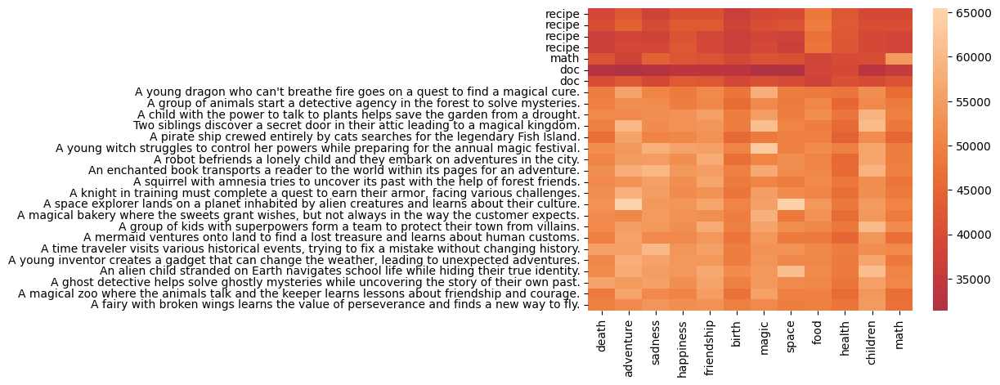

: 

In [10]:
scores = (theme_embeddings @ embedded_inputs.T) #* 100
sns.heatmap(scores.T.tolist(), center=0.0, xticklabels =queries_labels, yticklabels=labels)

<Axes: >

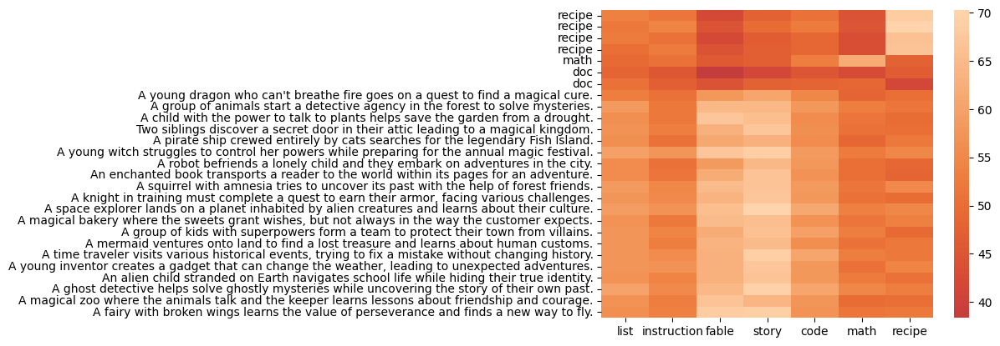

In [77]:
task = 'Given description of the structure of a text, retreive texts that follow this structure.'

queries_labels = [
    "list",
    "instruction",
    "fable",
    "story",
    "code",
    "math",
    "recipe",
]

queries = [get_detailed_instruct(task, i) for i in queries_labels]


structure_embeddings = embedd(queries)
structure_embeddings = F.normalize(structure_embeddings.to("cuda"))

scores = (structure_embeddings @ embedded_inputs.T) * 100
sns.heatmap(scores.T.tolist(), center=0.0, xticklabels =queries_labels, yticklabels=labels)

In [5]:
predicted_embeddings = torch.load("model_predictions.pth")
predicted_embeddings = predicted_embeddings[0:20, :].to("cuda").float()
predicted_embeddings = F.normalize(predicted_embeddings)


# Embedd the task of finding a theme

queries_labels = [
    'death',
    'adventure',
    'sadness',
    'happiness',
    'friendship',
    'birth',
    'magic',
    "space",
    "food",
    "health",
    "children",
]



task = 'Given a theme in a story, retreive texts where the theme appears.'
queries = [get_detailed_instruct(task, i) for i in queries_labels]


theme_embeddings = embedd(queries).to("cuda").float()
theme_embeddings = F.normalize(theme_embeddings)


scores = (theme_embeddings @ predicted_embeddings.T) * 100
sns.heatmap(scores.T.tolist(), center=0.0, xticklabels =queries_labels, yticklabels=prompts[0:20])

NameError: name 'tokenizer' is not defined

<Axes: >

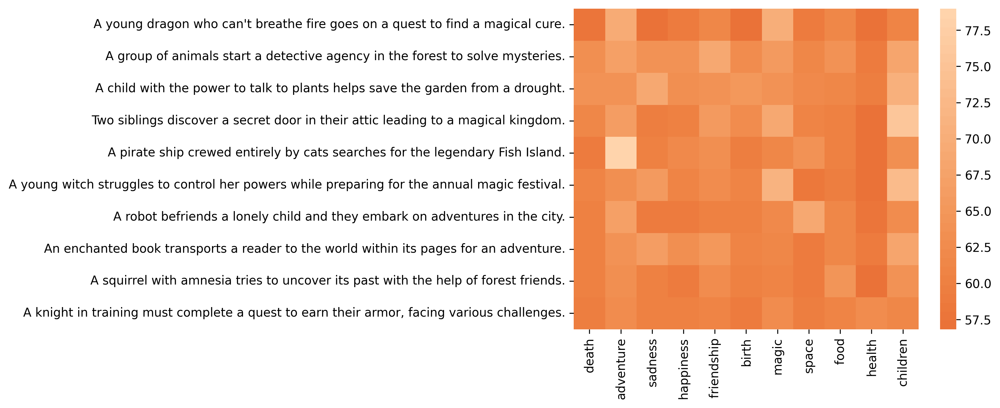

In [23]:
predicted_embeddings = torch.load("embeddings.pth")
predicted_embeddings = predicted_embeddings[0:10, :].to("cuda").float()
predicted_embeddings = F.normalize(predicted_embeddings)

# Embedd the task of finding a theme

queries_labels = [
    'death',
    'adventure',
    'sadness',
    'happiness',
    'friendship',
    'birth',
    'magic',
    "space",
    "food",
    "health",
    "children",
]



task = 'Given a theme in a story, retreive texts where the theme appears.'
queries = [get_detailed_instruct(task, i) for i in queries_labels]


theme_embeddings = embedd(queries).to("cuda").float()
theme_embeddings = F.normalize(theme_embeddings)


scores = (theme_embeddings @ predicted_embeddings.T) * 100
sns.heatmap(scores.T.tolist(), center=0.0, xticklabels =queries_labels, yticklabels=prompts[0:10])